## Day 7 Project


##### Libraries


In [1]:
import numpy as np
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt
from scipy.stats import kurtosis
import plotly.express as px
import plotly.graph_objects as go
from scipy.stats import norm
from scipy.stats import kurtosis
from sklearn.covariance import LedoitWolf


##### Importing the Data


# Ticker Explanations by Sector

| **Ticker** | **Company / Asset**                  | **Sector**              | **Description**                                                                 |
|------------|---------------------------------------|--------------------------|---------------------------------------------------------------------------------|
| GC=F       | Gold Futures                          | Commodity                | Futures contract representing the price of gold.                                |
| CL=F       | Crude Oil Futures                     | Commodity                | Futures contract representing the price of crude oil.                           |
| SPY        | SPDR S&P 500 ETF                      | ETF / Index              | Exchange-traded fund that tracks the S&P 500 index.                             |
| AAPL       | Apple Inc.                            | Technology               | Leading technology company, maker of iPhone, iPad, Mac, and services.           |
| GOOGL      | Alphabet Inc. (Class A)               | Technology               | Parent company of Google, specializing in search, ads, cloud, and AI.           |
| NVDA       | NVIDIA Corp.                          | Technology               | Semiconductor and AI company, leader in GPUs.                                   |
| TSLA       | Tesla Inc.                            | Consumer Discretionary   | Electric vehicle and clean energy company.                                       |
| JPM        | JPMorgan Chase & Co.                  | Financials               | Largest U.S. bank by assets, offering financial services worldwide.              |
| GS         | Goldman Sachs Group Inc.              | Financials               | Global investment banking, securities, and investment management firm.          |
| MS         | Morgan Stanley                        | Financials               | Multinational investment bank and financial services company.                    |
| RTX        | RTX Corporation (formerly Raytheon)   | Aerospace & Defense      | Aerospace and defense company, makes military and civilian technologies.         |
| NOC        | Northrop Grumman Corp.                | Aerospace & Defense      | Aerospace and defense technology company.                                        |
| BA         | The Boeing Company                    | Aerospace & Defense      | Major aerospace manufacturer and defense contractor.                             |
| GE         | General Electric Co.                  | Industrials              | Diversified industrial and technology company (aviation, energy, healthcare).    |
| UNP        | Union Pacific Corp.                   | Industrials              | Major U.S. railroad company.                                                     |
| HON        | Honeywell International Inc.          | Industrials              | Diversified tech and manufacturing company (aerospace, building, energy).        |
| PLD        | Prologis Inc.                         | Real Estate (REIT)       | Real estate investment trust (REIT) focusing on logistics facilities.            |
| JNJ        | Johnson & Johnson                     | Healthcare               | Healthcare and pharmaceutical products giant.                                    |
| WMT        | Walmart Inc.                          | Consumer Staples         | Largest retailer in the world, operating discount stores and e-commerce.         |
| PG         | Procter & Gamble Co.                  | Consumer Staples         | Consumer goods company (household and personal care products).                   |


In [2]:
# List of all tickers
tickers = [
    "GC=F",
    "CL=F",
    "SPY",
    "AAPL",
    "GOOGL",
    "NVDA",
    "JPM",
    "GS",
    "MS",
    "RTX",
    "NOC",
    "BA",
    "GE",
    "UNP",
    "HON",
    "PLD",
    "TSLA",
    "JNJ",
    "WMT",
    "PG",
]


df = yf.download(tickers, start="2000-01-01", end="2024-12-31")["Close"]

df.head()

C:\Users\Samneh\AppData\Local\Temp\ipykernel_24208\3234123479.py:26: FutureWarning: YF.download() has changed argument auto_adjust default to True
  df = yf.download(tickers, start="2000-01-01", end="2024-12-31")["Close"]
[*********************100%***********************]  20 of 20 completed


Ticker,AAPL,BA,CL=F,GC=F,GE,GOOGL,GS,HON,JNJ,JPM,MS,NOC,NVDA,PG,PLD,RTX,SPY,TSLA,UNP,WMT
Date,,,,,,,,,,,,,,,,,,,,
2000-01-03,0.840094,25.940281,NaN,NaN,129.933243,NaN,61.663685,30.331512,23.554600,23.125731,33.063717,14.034297,0.089425,27.213179,7.548299,11.412541,92.142532,NaN,6.507935,14.239624
2000-01-04,0.769266,25.899935,NaN,NaN,124.735947,NaN,57.779667,29.796444,22.692253,22.618320,30.614542,14.216764,0.087038,26.689562,7.429246,10.944632,88.539169,NaN,6.498490,13.706806
2000-01-05,0.780522,27.513651,NaN,NaN,124.519394,NaN,55.074013,29.395132,22.931789,22.478697,29.497107,14.200181,0.084172,26.181795,7.333995,10.727789,88.697594,NaN,6.498490,13.427078
2000-01-06,0.712978,27.796032,NaN,NaN,126.184196,NaN,57.430546,29.963650,23.650408,22.797829,30.063482,13.934753,0.078680,27.387749,7.476864,11.241357,87.272095,NaN,6.895199,13.573601
2000-01-07,0.746751,28.602884,NaN,NaN,131.070190,NaN,57.648746,31.568848,24.656456,23.216681,30.997232,14.266534,0.079994,29.577478,7.619740,11.686448,92.340500,NaN,6.847975,14.599270


In [3]:
df
df.dropna(how="all", inplace=True)  # Removing all non-trading days

In [4]:
# Log returns are better for the analysis as they are more normal and have less outliers
df_with_NaN = np.log(df / df.shift(1))

df_with_NaN = df_with_NaN.iloc[
    1:
]  # Removing the first row as it will have a NaN value



df_returns_filled = df_with_NaN.fillna(0)  # Filling the NaNs with 0

df_with_NaN.tail()

c:\Users\Samneh\Desktop\QuantDay1-14\.venv\Lib\site-packages\pandas\core\internals\blocks.py:395: RuntimeWarning: invalid value encountered in log
  result = func(self.values, **kwargs)


Ticker,AAPL,BA,CL=F,GC=F,GE,GOOGL,GS,HON,JNJ,JPM,MS,NOC,NVDA,PG,PLD,RTX,SPY,TSLA,UNP,WMT
Date,,,,,,,,,,,,,,,,,,,,
2024-12-23,0.003060,0.001915,-0.003172,-0.006258,0.003853,0.016683,0.008233,-0.005182,0.005522,0.003319,0.008149,-0.004996,0.036232,0.000297,0.007905,0.001287,0.005970,0.022404,0.003573,-0.020703
2024-12-24,0.011413,0.009243,0.012344,0.002943,0.014508,0.007575,0.020823,0.007719,0.003985,0.016310,0.020755,0.008292,0.003930,0.004925,0.005363,0.001713,0.011054,0.070991,0.011469,0.025462
2024-12-26,0.003171,0.005782,-0.006871,0.007150,0.003841,-0.002604,-0.002680,0.012849,-0.001853,0.003419,0.007605,0.002417,-0.002070,0.007196,0.020701,0.001796,0.000067,-0.017787,0.002087,0.001186
2024-12-27,-0.013331,0.001883,0.013978,-0.008219,-0.010469,-0.014626,-0.008727,-0.010187,-0.003647,-0.008135,-0.009969,-0.001865,-0.021088,-0.003709,-0.015557,-0.002824,-0.010582,-0.050745,-0.001304,-0.012253
2024-12-30,-0.013352,-0.023345,0.005509,-0.004250,-0.011710,-0.007917,-0.004575,-0.012760,-0.011859,-0.007701,-0.008000,-0.010300,0.003497,-0.014497,-0.001331,-0.012849,-0.011477,-0.033569,-0.009351,-0.011963


In [5]:
fig = go.Figure()
kurtosis_values = []

# Loop through each ticker
for ticker in df_with_NaN:

    returns_data = df_with_NaN[ticker].dropna()  # Dropping the NaNs, to allow the histogram to be plotted

    fig.add_trace(
        go.Histogram(
            x=returns_data,
            name="Histogram",
            histnorm="probability density",
            visible=(ticker == df_with_NaN.columns[0]),
        )
    )

    x_norm = np.linspace(returns_data.min(), returns_data.max(), 500)
    y_norm = norm.pdf(x_norm, returns_data.mean(), returns_data.std())

    kurtosis_values.append(kurtosis(returns_data))

    fig.add_trace(
        go.Scatter(
            x=x_norm,
            y=y_norm,
            mode="lines",
            name="Normal Dist.",
            visible=(ticker == df_with_NaN.columns[0]),
        )
    )

# Dropdown Menu Code
buttons = []
for i, ticker in enumerate(df_with_NaN.columns):
    visibility = [False] * len(fig.data)
    visibility[i * 2] = True
    visibility[i * 2 + 1] = True

    button = dict(
        label=ticker,
        method="update",
        args=[
            {"visible": visibility},
            {"title": f"Daily Log Returns Distribution: {ticker}"},
        ],
    )
    buttons.append(button)

fig.update_layout(
    updatemenus=[
        dict(
            active=0,
            buttons=buttons,
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.1,
            xanchor="left",
            y=1.1,
            yanchor="top",
        )
    ],
    title_text=f"Daily Log Returns Distribution: {df_with_NaN.columns[0]}",
    xaxis_title="Daily Log Return",
    yaxis_title="Probability Density",
    height=600,
    bargap=0.01,
)

fig.show()

##### In a lot of these histograms, we see that the charts follow a Leptokurtosis approach, in which the peak is higher but the tails are narrow, this signifies a safer asset/commodity, whereas the riskier assets/commodities tend to have fatter tails, deviating from the normal distribution


In [6]:
i = 0
for ticker in df_with_NaN.columns:
    print(f"Kurtosis of {ticker}: {kurtosis_values[i]}")  # Since default for fisher is True, it calculates the excess kurtosis, which is kurtosis - 3
    i += 1

Kurtosis of AAPL: 115.83391593663688
Kurtosis of BA: 13.8935904824564
Kurtosis of CL=F: 16.455633331387677
Kurtosis of GC=F: 5.383006837767974
Kurtosis of GE: 7.317187861716729
Kurtosis of GOOGL: 7.927047175968024
Kurtosis of GS: 12.292421062453238
Kurtosis of HON: 12.821243102932925
Kurtosis of JNJ: 14.211794894253348
Kurtosis of JPM: 14.55531775816565
Kurtosis of MS: 49.55090056354839
Kurtosis of NOC: 7.011366111628133
Kurtosis of NVDA: 12.989784864382642
Kurtosis of PG: 91.05273725231301
Kurtosis of PLD: 31.845147520315457
Kurtosis of RTX: 8.910956899282338
Kurtosis of SPY: 11.193431323262125
Kurtosis of TSLA: 4.778385977908437
Kurtosis of UNP: 5.607253535757106
Kurtosis of WMT: 8.531727868572933


##### This proves that all of them are Leptokurtic, and stocks like AAPL have extreme outliers do to major events like the dot-com bubble burst!

Kurtosis measures the extremity of the outliers, not the volatility, which is why more volatile assets are ranked lower than stocks like AAPL!


In [7]:
# Plotly and not plt as we want to plot an interactive plot
df_forward_filled = df.ffill()
fig = px.line(df_forward_filled, x=df.index, y=df.columns, title="Prices of All Assets")

# Update layout for better readability
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Price",
    legend_title="Assets",
    width=1200,
    height=700,
)

fig.show()

In [8]:
import plotly.express as px

# Plotly and not plt as we want to plot an interactive plot
fig = px.line(
    df_with_NaN,
    x=df_with_NaN.index,
    y=df_with_NaN.columns,
    title="Daily Returns of All Assets (Interactive)",
)

# Update layout for better readability
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Daily Return",
    legend_title="Assets",
    width=1200,
    height=700,
)

fig.show()

##### We tend to notice the volatility clusters here!


In [9]:
# Number of trading days in a year
trading_days = 252

# Calculate the mean daily log return for each asset
mean_log_returns = df_with_NaN.mean()

# Annualize the log returns
annualized_log_returns = mean_log_returns * trading_days

# Converting annualized log returns back to simple/arithmetic returns
annualized_simple_returns = np.exp(annualized_log_returns) - 1


print("--- Annualized Returns from Log Returns (2000-2024) ---")
for ticker in annualized_simple_returns.index:
    return_percentage = annualized_simple_returns[ticker] * 100
    print(f"The annualized return of {ticker:<8} is {return_percentage:>8.4f}%")

--- Annualized Returns from Log Returns (2000-2024) ---
The annualized return of AAPL     is  25.6363%
The annualized return of BA       is   8.8251%
The annualized return of CL=F     is   5.7904%
The annualized return of GC=F     is   9.4659%
The annualized return of GE       is   1.4210%
The annualized return of GOOGL    is  23.5918%
The annualized return of GS       is   9.6062%
The annualized return of HON      is   9.1559%
The annualized return of JNJ      is   7.3952%
The annualized return of JPM      is   9.9810%
The annualized return of MS       is   5.9594%
The annualized return of NOC      is  14.2559%
The annualized return of NVDA     is  34.8180%
The annualized return of PG       is   7.4529%
The annualized return of PLD      is  11.1751%
The annualized return of RTX      is  10.9389%
The annualized return of SPY      is   7.9229%
The annualized return of TSLA     is  46.8830%
The annualized return of UNP      is  15.5043%
The annualized return of WMT      is   7.7449%


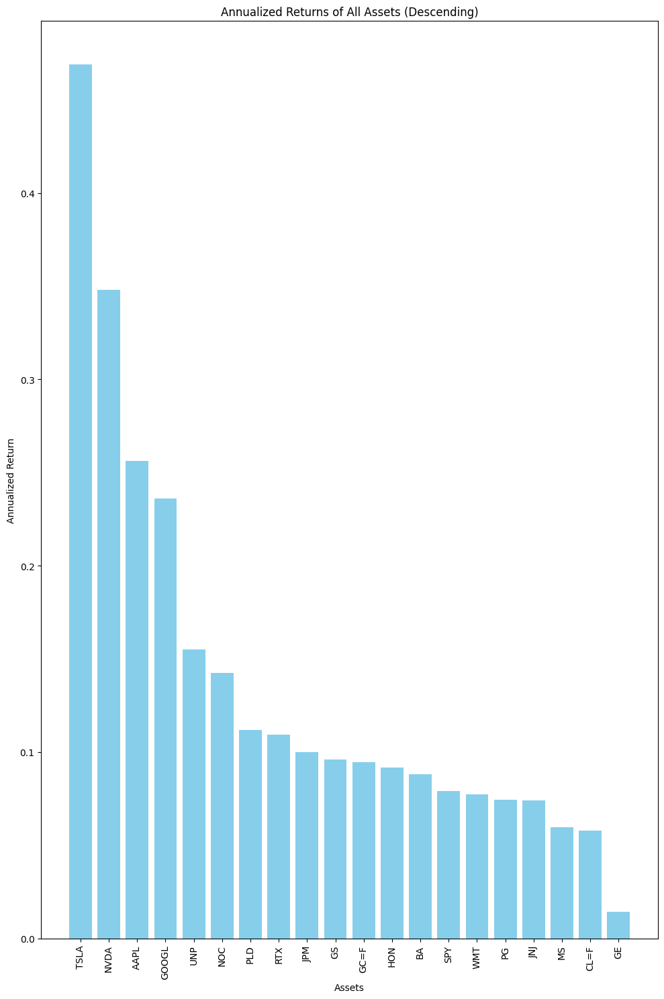

In [10]:
sorted_returns = annualized_simple_returns.sort_values(ascending=False)

plt.figure(figsize=(10, 15))
plt.bar(sorted_returns.index, sorted_returns.values, color="skyblue")
plt.xlabel("Assets")
plt.ylabel("Annualized Return")
plt.title("Annualized Returns of All Assets (Descending)")
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [11]:
summary_stats = df_with_NaN.describe()

summary_stats_transposed = summary_stats.T

print("\n\n--- Transposed for Better Readability ---")
print(summary_stats_transposed)



--- Transposed for Better Readability ---
         count      mean       std       min       25%       50%       75%  \
Ticker                                                                       
AAPL    6284.0  0.000906  0.025251 -0.731248 -0.009855  0.000949  0.012598   
BA      6284.0  0.000336  0.022066 -0.272444 -0.009857  0.000547  0.010965   
CL=F    6096.0  0.000223  0.026012 -0.282206 -0.012694  0.001078  0.013456   
GC=F    6085.0  0.000359  0.010864 -0.098206 -0.004775  0.000459  0.006167   
GE      6284.0  0.000056  0.020862 -0.164394 -0.008784  0.000000  0.009236   
GOOGL   5123.0  0.000841  0.019173 -0.123685 -0.008034  0.000854  0.010077   
GS      6284.0  0.000364  0.022500 -0.210223 -0.009946  0.000363  0.010962   
HON     6284.0  0.000348  0.018708 -0.186454 -0.007942  0.000575  0.008710   
JNJ     6284.0  0.000283  0.012067 -0.172516 -0.005221  0.000279  0.005996   
JPM     6284.0  0.000378  0.023412 -0.232278 -0.008685  0.000319  0.009637   
MS      6284.0  0.00

In [12]:
# Making sure our stdev is annualized

stdev = df_with_NaN.std()

stdev = stdev * np.sqrt(trading_days)

stdev.sort_values(ascending=False)

Ticker
NVDA     0.591616
TSLA     0.571258
MS       0.458428
CL=F     0.412923
AAPL     0.400843
PLD      0.375764
JPM      0.371656
GS       0.357176
BA       0.350288
GE       0.331167
GOOGL    0.304369
HON      0.296980
UNP      0.278786
RTX      0.271222
NOC      0.251023
WMT      0.232960
PG       0.212051
SPY      0.193796
JNJ      0.191552
GC=F     0.172457
dtype: float64

##### Here we can see the volatility of all the assets, with NVDA being one of the most volatile, meaning its the "riskiest", which is supported with it being one of the most rewarding.
While gold is the least volatile, as its termed a stable and safe asset


In [13]:
# here lets calculate the rolling volatility of each asset with a window of 21 days
rolling_volatility = df_with_NaN.rolling(window=21).std() # Pandas will ignore the NaN values

# lets plot the rolling volatility
fig = px.line(
    rolling_volatility,
    x=rolling_volatility.index,
    y=rolling_volatility.columns,
    title="Rolling Volatility of All Assets",
)

# Update layout for better readability
fig.update_layout(
    xaxis_title="Date",
    yaxis_title="Daily Return",
    legend_title="Assets",
    width=1200,
    height=700,
)

fig.show()

#### We see 3 periods in which there were large volatlity clusters, early 2000s (Dot-com Bubble), 2008 (Financial Crisis), and 2020 (Covid-19 Recession)!


In [14]:
#  Volatility Cone
# We'll calculate volatility for windows from 1 month to 1 year
window_sizes = [21, 42, 63, 126, 252]  # Approx. 1m, 2m, 3m, 6m, 1yr, excluding weekends, holidays and non-trading days!

fig = go.Figure()
for ticker in df_with_NaN.columns:

    # Isolate the returns for the current ticker and drop its NaNs
    returns_data = df_with_NaN[ticker].dropna()
    
    # Lists to store the cone boundaries
    max_vols = []
    min_vols = []
    median_vols = []

    # Calculate boundaries for each window size
    for window in window_sizes:
        # Calculate rolling standard deviation (daily volatility)
        rolling_std = returns_data.rolling(window=window).std()

        # Annualize the daily volatility
        annualized_vol = rolling_std * np.sqrt(252)

        # Append the max, min, and median to our lists
        max_vols.append(annualized_vol.max())
        min_vols.append(annualized_vol.min())
        median_vols.append(annualized_vol.median())

    # Max Volatility Line (Top of the cone)
    fig.add_trace(
        go.Scatter(
            x=window_sizes,
            y=max_vols,
            mode="lines",
            line=dict(color="rgba(200, 200, 200, 0.8)"),
            name="Max Vol",
            visible=(ticker == df_with_NaN.columns[0]),
        )
    )

    # Min Volatility Line (Bottom of the cone, filled to the max line)
    fig.add_trace(
        go.Scatter(
            x=window_sizes,
            y=min_vols,
            mode="lines",
            fill="tonexty",  # This is the magic that creates the shaded cone area
            fillcolor="rgba(200, 200, 200, 0.4)",
            line=dict(color="rgba(200, 200, 200, 0.8)"),
            name="Min Vol",
            visible=(ticker == df_with_NaN.columns[0]),
        )
    )

    # Median Volatility Line
    fig.add_trace(
        go.Scatter(
            x=window_sizes,
            y=median_vols,
            mode="lines+markers",
            line=dict(color="blue", width=3),
            name="Median Vol",
            visible=(ticker == df_with_NaN.columns[0]),
        )
    )

buttons = []
for i, ticker in enumerate(df_with_NaN.columns):
    # Each ticker has 3 traces (max, min, median)
    visibility = [False] * (len(df_with_NaN.columns) * 3)
    visibility[i * 3] = True  # Make the i-th Max trace visible
    visibility[i * 3 + 1] = True  # Make the i-th Min trace visible
    visibility[i * 3 + 2] = True  # Make the i-th Median trace visible

    button = dict(
        label=ticker,
        method="update",
        args=[
            {"visible": visibility},
            {"title": f"Historical Volatility Cone: {ticker}"},
        ],
    )
    buttons.append(button)

# Add the dropdown and update the layout
fig.update_layout(
    updatemenus=[
        dict(
            active=0,
            buttons=buttons,
            direction="down",
            pad={"r": 10, "t": 10},
            showactive=True,
            x=0.1,
            xanchor="left",
            y=1.1,
            yanchor="top",
        )
    ],
    title_text=f"Historical Volatility Cone: {df_with_NaN.columns[0]}",
    xaxis_title="Time Window (Trading Days)",
    yaxis_title="Annualized Volatility",
    yaxis_tickformat=".0%",  # Format Y-axis as percentage
    height=600,
)

fig.show()

### ARIMA Forecasting


In [15]:
from statsmodels.tsa.stattools import adfuller

for ticker in df_with_NaN.columns:
    # Check if the series is stationary, by comparing the pval with 0.05, if its below, we reject the h0, meaning its stationary!
    if adfuller(df_with_NaN[ticker].dropna())[1] < 0.05:
        print(f"{ticker} is stationary")
    else:
        print(f"{ticker} is not stationary")

AAPL is stationary
BA is stationary
CL=F is stationary
GC=F is stationary
GE is stationary
GOOGL is stationary
GS is stationary
HON is stationary
JNJ is stationary
JPM is stationary
MS is stationary
NOC is stationary
NVDA is stationary
PG is stationary
PLD is stationary
RTX is stationary
SPY is stationary
TSLA is stationary
UNP is stationary
WMT is stationary


#### Since all of them are stationary, the ARIMA d-value is 0, however we will utilize pmdarima's auto_arima model!


In [16]:
import warnings
from sklearn.exceptions import InconsistentVersionWarning
from statsmodels.tools.sm_exceptions import ValueWarning

# Suppress FutureWarning and other specific warnings
warnings.simplefilter("ignore", category=FutureWarning)
warnings.simplefilter("ignore", category=InconsistentVersionWarning)
warnings.simplefilter("ignore", category=ValueWarning)

In [17]:
import pmdarima as pm

# 1) Ensure prices are numeric and clean
prices = df.apply(pd.to_numeric, errors="coerce")

n_periods = 120 # 120 days to estimate!

models = {}
point_forecasts = {}
conf_intervals = {}

for ticker in prices.columns:
    y = prices[ticker].dropna()
    # guardrails: need enough non-NA and non-constant variation
    if len(y) < 20 or np.isclose(y.std(), 0.0, atol=1e-12):
        continue

    # 2) Fit ARIMA on PRICE levels; differencing inside
    model = pm.auto_arima(
        y,
        start_p=1, start_q=1,
        max_p=3, max_q=3,
        d=1, seasonal=False,
        test="adf",
        m=1,
        start_P=0, D=0,
        stepwise=True,
        error_action="ignore",
        suppress_warnings=True,
        trace=False,
    )
    models[ticker] = model

    # 3) Forecast the series
    fc, conf = model.predict(n_periods=n_periods, return_conf_int=True)

    # Safety: coerce to float and check
    fc = np.asarray(fc, dtype=float)
    conf = np.asarray(conf, dtype=float)

    # 4) Forecast index continuing historical frequency
    freq = pd.infer_freq(y.index)
    if freq is None:
        freq = "B" # Default to business day frequency if inference fails

    start = y.index[-1] + pd.tseries.frequencies.to_offset(freq)
    f_index = pd.date_range(start=start, periods=n_periods, freq=freq)

    # 5) Transforming the prices to align with the dates.
    point_forecasts[ticker] = pd.Series(fc, index=f_index, name="price_forecast")

    conf_intervals[ticker] = pd.DataFrame({'lower': conf[:,0], 'upper': conf[:,1]}, index=f_index)   

    # Commented out due to us utilizing prices and not returns in our ARIMA model.
    # # Get the last known price
    # last_price = y.iloc[-1]
    
    # # Cumulatively sum the return forecasts and add to the last price
    # price_forecast_values = last_price + np.cumsum(fc)
    # point_forecasts[ticker] = pd.Series(price_forecast_values, index=f_index, name="price_forecast")

    # # Do the same for the confidence interval bounds
    # # The conf array is relative to the forecast, so we apply the same logic
    # lower_ci = last_price + np.cumsum(conf[:, 0])
    # upper_ci = last_price + np.cumsum(conf[:, 1])
    # conf_intervals[ticker] = pd.DataFrame({'lower': lower_ci, 'upper': upper_ci}, index=f_index)


# 6) Print forecasts for sanity check (now in price levels)
for ticker, s in point_forecasts.items():
    print(f"\n=== {ticker} {n_periods}-step Price Forecast ===")
    print(s.to_string())


=== AAPL 120-step Price Forecast ===
2024-12-31    251.452986
2025-01-01    251.658912
2025-01-02    251.779649
2025-01-03    251.819542
2025-01-06    251.859436
2025-01-07    251.899330
2025-01-08    251.939224
2025-01-09    251.979118
2025-01-10    252.019012
2025-01-13    252.058905
2025-01-14    252.098799
2025-01-15    252.138693
2025-01-16    252.178587
2025-01-17    252.218481
2025-01-20    252.258375
2025-01-21    252.298268
2025-01-22    252.338162
2025-01-23    252.378056
2025-01-24    252.417950
2025-01-27    252.457844
2025-01-28    252.497737
2025-01-29    252.537631
2025-01-30    252.577525
2025-01-31    252.617419
2025-02-03    252.657313
2025-02-04    252.697207
2025-02-05    252.737100
2025-02-06    252.776994
2025-02-07    252.816888
2025-02-10    252.856782
2025-02-11    252.896676
2025-02-12    252.936569
2025-02-13    252.976463
2025-02-14    253.016357
2025-02-17    253.056251
2025-02-18    253.096145
2025-02-19    253.136039
2025-02-20    253.175932
2025-02-21  

In [18]:
# 6) Interactive plot with dropdown
fig = go.Figure()
tickers = list(point_forecasts.keys())
groups = []

for i, t in enumerate(tickers):
    y_hist = prices[t].dropna()
    fc = point_forecasts[t]
    ci = conf_intervals[t]

    fig.add_trace(go.Scatter(
        x=y_hist.index, y=y_hist.values, mode="lines",
        name=f"{t} - History", line=dict(color="#1f77b4"),
        visible=(i == 0),
    ))
    fig.add_trace(go.Scatter(
        x=fc.index, y=fc.values, mode="lines",
        name=f"{t} - Forecast", line=dict(color="#ff7f0e", dash="dash"),
        visible=(i == 0),
    ))
    fig.add_trace(go.Scatter(
        x=list(ci.index) + list(ci.index[::-1]),
        y=list(ci["upper"].values) + list(ci["lower"].values[::-1]),
        fill="toself",
        fillcolor="rgba(255,127,14,0.2)",
        line=dict(color="rgba(255,127,14,0)"),
        name=f"{t} - 95% CI", hoverinfo="skip",
        visible=(i == 0),
    ))
    groups.append((3*i, 3*i+1, 3*i+2))

buttons = []
num_traces = len(fig.data)
for i, t in enumerate(tickers):
    vis = [False] * num_traces
    a, b, c = groups[i]
    vis[a] = vis[b] = vis[c] = True
    buttons.append(dict(
        label=t,
        method="update",
        args=[{"visible": vis},
              {"title": f"{t} Price: History and {n_periods}-Step ARIMA Forecast"}]
    ))

fig.update_layout(
    title=(f"{tickers[0]} Price: History and {n_periods}-Step ARIMA Forecast" if tickers else "ARIMA Forecasts"),
    xaxis_title="Date",
    yaxis_title="Price",
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="left", x=0),
    updatemenus=[dict(type="dropdown", buttons=buttons, x=1.0, xanchor="right", y=1.15, yanchor="top")],
    template="plotly_white",
)

fig.show()

##### When constructing an optimal portfolio, the primary goal is to balance risk and return. While ARIMA is a tool for forecasting future price trends (Although not a great one), GARCH is more directly applicable to portfolio optimization because it models volatility, which is a key measure of risk.

In [19]:
from arch import arch_model
from arch.univariate import ARX, GARCH, StudentsT, Normal

# Containers
gjr_models = {}
price_forecasts = {}
price_conf_intervals = {}

for ticker in df.columns:
    print(f"\n\n===== Processing {ticker} =====")

    y_price = df[ticker].dropna()

    if len(y_price) < 50:
        print("❌ Skipping: not enough data")
        continue

    # 2. Log returns
    # y_ret = np.log(y_price).diff().dropna()

    y_ret= df_with_NaN[ticker].dropna()
    
    if len(y_ret) < 50:
        print("❌ Skipping: not enough returns data")
        continue

    # Historical volatility for scaling
    hist_std = y_ret.std()

    # 3. Constant Mean (lags=1) with GJR-GARCH
    # We use an AR(1)-GJR-GARCH(1,1) model with a Student's T distribution.
    # This model is chosen to capture three key stylized facts of financial returns:
    # 1. AR(1) Mean: Accounts for any small, linear autocorrelation in the returns.
    # 2. GJR-GARCH Volatility: Models volatility clustering and the leverage effect (i.e., negative news impacts volatility more than positive news).
    # 3. Student's T Distribution: Captures the "fat-tailed" nature of returns, accounting for more frequent extreme events than a normal distribution would suggest.
    model = ARX(y_ret, lags=1, rescale=True)
    model.volatility = GARCH(p=1, o=1, q=1)
    model.distribution = StudentsT()
    
    try:
        res = model.fit(disp="off")
        gjr_models[ticker] = res
    except Exception as e:
        print(f"❌ Could not fit model: {e}")
        continue

    # Debug params
    print("✅ Model fitted")
    if "alpha[1]" in res.params and "beta[1]" in res.params:
        alpha = res.params["alpha[1]"]
        beta = res.params["beta[1]"]
        print(f"  → α + β = {alpha + beta:.4f} (stationary < 1)")
        if alpha + beta >= 1:
            print("⚠️ WARNING: Model is near/explosive (non-stationary)")

    # 4. Simulate multiple paths
    n_sims = 120
    all_sims = []
    for i in range(n_sims):
        sim_data = model.simulate(res.params, nobs=n_periods)
        sim_returns = sim_data.data

        # Rescale to historical volatility
        if np.std(sim_returns) > 0:
            sim_returns = sim_returns * (hist_std / np.std(sim_returns))

        # Clip extreme shocks (> ±20% log-return in a day)
        sim_returns = np.clip(sim_returns, -0.12, 0.1)

        all_sims.append(sim_returns)

    sim_returns = np.column_stack(all_sims)  # (n_periods, n_sims)

    # Debug simulated returns
    print("📊 Simulated returns (after rescale+clip):")
    print(f"  Mean: {np.mean(sim_returns):.6f}, Std: {np.std(sim_returns):.6f}")
    print(f"  Min: {np.min(sim_returns):.6f}, Max: {np.max(sim_returns):.6f}")

    # 5. Convert simulated returns into price paths
    last_price = y_price.iloc[-1]
    sim_prices = last_price * np.exp(np.cumsum(sim_returns, axis=0))

    # Debug price sanity
    print("📊 Price path sanity:")
    print(f"  Median final price: {np.median(sim_prices[-1, :]):.2f}")
    print(f"  5% CI final price: {np.percentile(sim_prices[-1, :], 5):.2f}")
    print(f"  95% CI final price: {np.percentile(sim_prices[-1, :], 95):.2f}")

    # 6. Expected price forecast
    exp_price = np.median(sim_prices, axis=1)
    lo_price = np.percentile(sim_prices, 5, axis=1)
    hi_price = np.percentile(sim_prices, 95, axis=1)

    # 7. Forecast index
    freq = pd.infer_freq(y_price.index) or "B"
    start = y_price.index[-1] + pd.tseries.frequencies.to_offset(freq)
    f_index = pd.date_range(start=start, periods=n_periods, freq=freq)

    # Store
    price_forecasts[ticker] = pd.Series(exp_price, index=f_index, name="price_forecast")
    price_conf_intervals[ticker] = pd.DataFrame({"lower": lo_price, "upper": hi_price}, index=f_index)

    print(f"✅ Finished {ticker} (Forecast horizon: {n_periods} steps)")

# Final results
for ticker in price_forecasts:
    print(f"\n=== {ticker} {n_periods}-step Expected Price (GJR-GARCH) ===")
    print(price_forecasts[ticker].head(10))




===== Processing AAPL =====
✅ Model fitted
  → α + β = 0.9625 (stationary < 1)
📊 Simulated returns (after rescale+clip):
  Mean: 0.002212, Std: 0.025195
  Min: -0.120000, Max: 0.100000
📊 Price path sanity:
  Median final price: 325.18
  5% CI final price: 209.72
  95% CI final price: 503.75
✅ Finished AAPL (Forecast horizon: 120 steps)


===== Processing BA =====
✅ Model fitted
  → α + β = 0.9562 (stationary < 1)
📊 Simulated returns (after rescale+clip):
  Mean: 0.001006, Std: 0.022099
  Min: -0.120000, Max: 0.100000
📊 Price path sanity:
  Median final price: 205.59
  5% CI final price: 124.43
  95% CI final price: 291.88
✅ Finished BA (Forecast horizon: 120 steps)


===== Processing CL=F =====
✅ Model fitted
  → α + β = 0.9537 (stationary < 1)
📊 Simulated returns (after rescale+clip):
  Mean: 0.000860, Std: 0.026075
  Min: -0.117670, Max: 0.100000
📊 Price path sanity:
  Median final price: 80.77
  5% CI final price: 48.84
  95% CI final price: 118.17
✅ Finished CL=F (Forecast horizo

In [20]:
# 8) Single interactive figure with dropdown to switch tickers (price + CI)
fig = go.Figure()
all_tickers = list(price_forecasts.keys())
trace_groups = []

for i, ticker in enumerate(all_tickers):
    y_price = df[ticker].dropna()
    pf = price_forecasts[ticker]
    pci = price_conf_intervals[ticker]

    # Historical price
    hist_trace = go.Scatter(
        x=y_price.index, y=y_price.values, mode="lines",
        name=f"{ticker} - Price (Hist)",
        line=dict(color="#1f77b4"),
        visible=True if i == 0 else False,
    )
    fig.add_trace(hist_trace)

    # Expected price path
    fc_trace = go.Scatter(
        x=pf.index, y=pf.values, mode="lines",
        name=f"{ticker} - Expected Price",
        line=dict(color="#ff7f0e", dash="dash"),
        visible=True if i == 0 else False,
    )
    fig.add_trace(fc_trace)

    # Confidence band (price)
    band_trace = go.Scatter(
        x=list(pci.index) + list(pci.index[::-1]),
        y=list(pci["upper"].values) + list(pci["lower"].values[::-1]),
        fill="toself",
        fillcolor="rgba(255,127,14,0.2)",
        line=dict(color="rgba(255,127,14,0)"),
        name=f"{ticker} - 95% CI (Price)",
        hoverinfo="skip",
        visible=True if i == 0 else False,
    )
    fig.add_trace(band_trace)

    trace_groups.append((3 * i, 3 * i + 1, 3 * i + 2))

# Dropdown to toggle tickers
buttons = []
num_traces = len(fig.data)
for i, ticker in enumerate(all_tickers):
    visible = [False] * num_traces
    h, f, b = trace_groups[i]
    visible[h] = True
    visible[f] = True
    visible[b] = True
    buttons.append(dict(
        label=ticker,
        method="update",
        args=[{"visible": visible},
              {"title": f"{ticker} Price: GJR-GARCH Expected Path ({n_periods} steps)"}],
    ))

fig.update_layout(
    title=f"{all_tickers[0]} Price: GJR-GARCH Expected Path ({n_periods} steps)" if all_tickers else "GJR-GARCH Forecasts",
    xaxis_title="Date",
    yaxis_title="Price",
    legend=dict(orientation="h", yanchor="bottom", y=1.02, xanchor="left", x=0),
    updatemenus=[dict(type="dropdown", x=1.0, xanchor="right", y=1.15, yanchor="top",
                      buttons=buttons, showactive=True)],
    template="plotly_white",
)

fig.show()

In [21]:
# We need to build a forward-looking covariance matrix, to see how assets are expected to move relative to each other in the future
def garch_forward_cov(gjr_models: dict,
                      df_prices: pd.DataFrame,
                      n_periods: int = 20,
                      n_sims: int = 500) -> pd.DataFrame:
    """
    Compute forward-looking covariance matrix with robust data cleaning and GARCH refitting.
    """
    tickers = list(gjr_models.keys())
    if not tickers:
        raise ValueError("gjr_models is empty")
    if df_prices.empty:
        raise ValueError("df_prices is empty")
    if not all(t in df_prices.columns for t in tickers):
        raise ValueError("Some tickers in gjr_models are not in df_prices")

    print("\n=== Debugging garch_forward_cov ===")
    print(f"Tickers: {tickers}")
    print(f"n_periods: {n_periods}, n_sims: {n_sims}")

    # Clean price data: drop rows with missing or invalid (<=0) prices
    df_prices_clean = df_prices.dropna(how="any").copy()
    df_prices_clean = df_prices_clean[(df_prices_clean > 0).all(axis=1)]  # Drop rows with <=0 prices
    for t in tickers:
        if df_prices_clean[t].isna().sum() > 0:
            print(f"Warning: {t} has {df_prices_clean[t].isna().sum()} missing prices after dropping, using forward-fill")
            df_prices_clean[t] = df_prices_clean[t].fillna(method="ffill")
    print(f"Valid date range after cleaning: {df_prices_clean.index[0]} to {df_prices_clean.index[-1]}, {len(df_prices_clean)} days")

    if df_prices_clean.empty:
        raise ValueError("No valid data after cleaning missing/invalid prices")

    # Calculate historical daily volatilities (3 years)
    hist_vols = {}
    trading_days = 756
    for t in tickers:
        log_returns = np.log(df_prices_clean[t] / df_prices_clean[t].shift(1)).dropna()
        if len(log_returns) < trading_days:
            hist_vols[t] = log_returns.std() if len(log_returns) > 0 else 0.02
            print(f"Warning: Insufficient data for {t}, using full period std = {hist_vols[t]:.6f}")
        else:
            hist_vols[t] = log_returns.tail(trading_days).std()
        print(f"{t}: Historical daily volatility = {hist_vols[t]:.6f}")

    sim_ret_matrix = []
    for ticker in tickers:
        res = gjr_models[ticker]
        print(f"{ticker}: GARCH params = {res.params}, Log-likelihood = {res.loglikelihood:.2f}, AIC = {res.aic:.2f}")

        is_scaled = False  # Flag to track if model was fitted on scaled data

        # Refit if poor fit
        if res.loglikelihood < -1000 or np.any(np.isnan(res.params)):
            print(f"Warning: Poor GARCH fit for {ticker}, refitting model")
            log_returns = np.log(df_prices_clean[ticker] / df_prices_clean[ticker].shift(1)).dropna()
            log_returns = log_returns[np.abs(log_returns) < 0.1]  # Remove outliers
            model = arch_model(log_returns * 100, vol="Garch", p=1, o=1, q=1, dist="normal")
            res = model.fit(disp="off")
            gjr_models[ticker] = res
            is_scaled = True  # Mark as scaled

        sims = []
        for _ in range(n_sims):
            sim_data = res.model.simulate(res.params, nobs=n_periods)
            sim = sim_data.data
            if is_scaled:
                sim /= 100  # Adjust back if fitted on scaled data

            max_daily_return = 3 * hist_vols[ticker]
            sim = np.clip(sim, -max_daily_return, max_daily_return)
            sims.append(sim)
        sims = np.column_stack(sims)

        sim_std = np.std(sims)
        if sim_std > 0:
            sims = sims * (hist_vols[ticker] / sim_std)

        print(f"{ticker}: Mean simulated return = {np.mean(sims):.6f}, "
              f"Std dev = {np.std(sims):.6f}, "
              f"Min = {np.min(sims):.6f}, Max = {np.max(sims):.6f}")

        sim_ret_matrix.append(sims)

    n_assets = len(tickers)
    all_sims_flat = np.zeros((n_periods * n_sims, n_assets))
    for i in range(n_assets):
        all_sims_flat[:, i] = sim_ret_matrix[i].flatten()

    Sigma_forward_daily = np.cov(all_sims_flat, rowvar=False)
    print("Daily covariance matrix:")
    print(pd.DataFrame(Sigma_forward_daily, index=tickers, columns=tickers).to_string(float_format="%.6f"))
    print("Daily variances:", np.diag(Sigma_forward_daily))

    if np.any(np.isnan(Sigma_forward_daily)) or np.any(np.isinf(Sigma_forward_daily)):
        raise ValueError("Sigma_forward_daily contains NaN or Inf values")
    if np.linalg.eigvals(Sigma_forward_daily).min() < -1e-10:
        print("Warning: Sigma_forward_daily is not positive semi-definite, adding regularization")
        Sigma_forward_daily += 1e-6 * np.eye(n_assets)

    Sigma_forward_annual = Sigma_forward_daily * 252
    print("Annualized GARCH covariance matrix:")
    print(pd.DataFrame(Sigma_forward_annual, index=tickers, columns=tickers).to_string(float_format="%.6f"))
    print("Annualized variances:", np.diag(Sigma_forward_annual))

    max_variance = 1.0
    if np.any(np.diag(Sigma_forward_annual) > max_variance):
        print("Warning: Some variances exceed 1.0, scaling down")
        scale_factor = max_variance / np.max(np.diag(Sigma_forward_annual))
        Sigma_forward_annual *= scale_factor
        print("Scaled annualized covariance matrix:")
        print(pd.DataFrame(Sigma_forward_annual, index=tickers, columns=tickers).to_string(float_format="%.6f"))
        print("Scaled annualized variances:", np.diag(Sigma_forward_annual))

    return pd.DataFrame(Sigma_forward_annual, index=tickers, columns=tickers)


##### Covariance & Correlation


In [22]:
# Historical Covariance matrix
cov_matrix = (
    df_with_NaN.cov() * 252
)  # Making sure the covariance is annualized

cov_matrix.head()
cov_matrix.style.background_gradient(cmap="coolwarm")

Ticker,AAPL,BA,CL=F,GC=F,GE,GOOGL,GS,HON,JNJ,JPM,MS,NOC,NVDA,PG,PLD,RTX,SPY,TSLA,UNP,WMT
Ticker,,,,,,,,,,,,,,,,,,,,
AAPL,0.160675,0.040144,0.015355,-0.001098,0.044406,0.051079,0.053343,0.041205,0.016604,0.051813,0.066089,0.022031,0.097561,0.016298,0.043652,0.035548,0.042554,0.057023,0.035123,0.023354
BA,0.040144,0.122702,0.023468,0.000752,0.057121,0.039632,0.055316,0.055667,0.021295,0.057792,0.070260,0.037408,0.057181,0.020083,0.048485,0.056892,0.040383,0.057861,0.043636,0.021553
CL=F,0.015355,0.023468,0.170506,0.013558,0.019892,0.017945,0.023897,0.017220,0.004838,0.020635,0.030175,0.012407,0.025245,0.004710,0.018928,0.017616,0.017829,0.031479,0.022402,-0.000940
GC=F,-0.001098,0.000752,0.013558,0.029741,-0.002154,0.000330,-0.002866,-0.000704,-0.000767,-0.005182,-0.004681,-0.000033,0.000271,-0.000128,0.002491,-0.000467,-0.000065,0.004276,0.000422,-0.001628
GE,0.044406,0.057121,0.019892,-0.002154,0.109671,0.035429,0.061956,0.053270,0.021229,0.071790,0.079389,0.027687,0.062561,0.021322,0.055791,0.049565,0.042406,0.041294,0.042051,0.024009
GOOGL,0.051079,0.039632,0.017945,0.000330,0.035429,0.092641,0.046696,0.034999,0.017047,0.045073,0.058977,0.021183,0.066763,0.017034,0.048966,0.031691,0.036397,0.052015,0.033801,0.017590
GS,0.053343,0.055316,0.023897,-0.002866,0.061956,0.046696,0.127575,0.053496,0.021364,0.096236,0.134189,0.029807,0.080610,0.019084,0.063419,0.048172,0.049522,0.045973,0.048720,0.026441
HON,0.041205,0.055667,0.017220,-0.000704,0.053270,0.034999,0.053496,0.088197,0.021437,0.057864,0.069490,0.032290,0.059444,0.021192,0.046158,0.050846,0.039553,0.035809,0.043654,0.022904
JNJ,0.016604,0.021295,0.004838,-0.000767,0.021229,0.017047,0.021364,0.021437,0.036692,0.023345,0.030674,0.018104,0.015848,0.018644,0.022908,0.020386,0.019203,0.012695,0.018106,0.015291


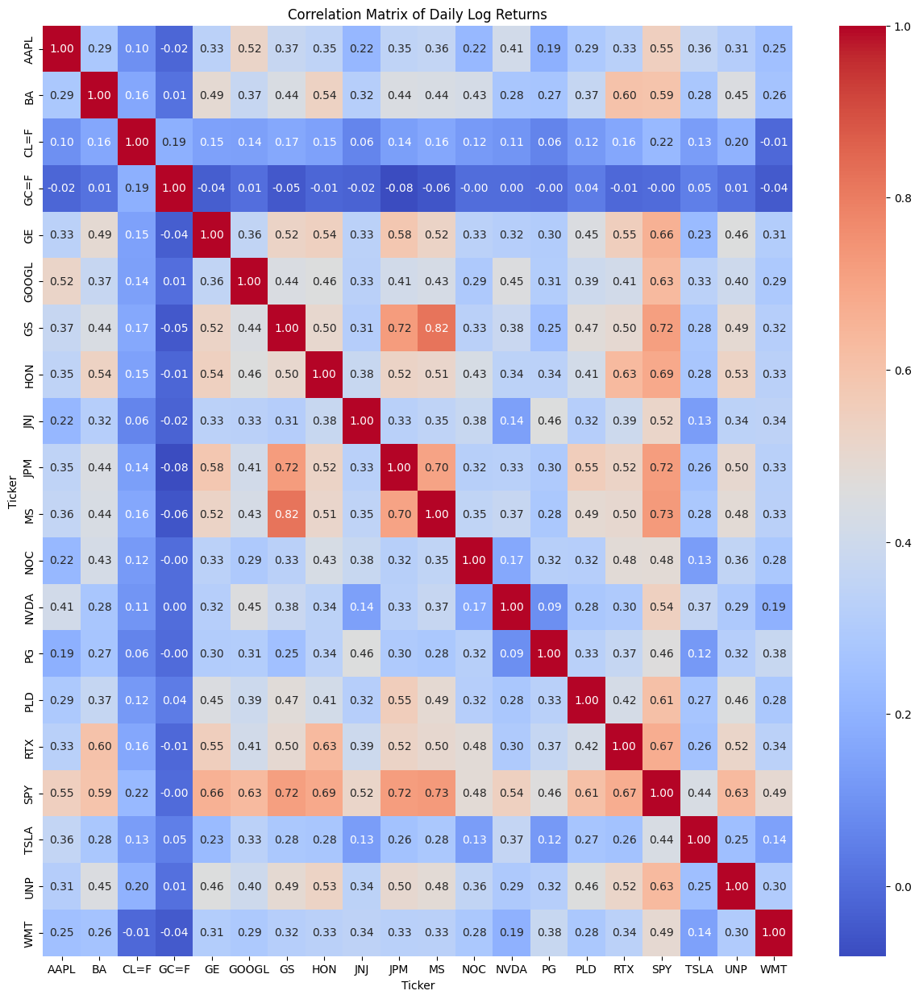

In [23]:
import seaborn as sns

# Correlation Matrix, just for the funsies
plt.figure(figsize=(15, 15))
sns.heatmap(df_with_NaN.corr(), annot=True, cmap="coolwarm", fmt=".2f")
plt.title("Correlation Matrix of Daily Log Returns")
plt.show()

In [24]:
import cvxpy as cp


def build_expected_returns_annual(df_prices: pd.DataFrame,
                                 price_forecasts: dict,
                                 forecast_horizon_days: int = 20,
                                 default_to_hist: bool = True,
                                 max_daily_return: float = 0.05,
                                 max_annual_return: float = 0.25,
                                 hist_weight: float = 0.8) -> pd.Series:
    """
    Compute expected annual returns with robust data cleaning and conservative blending.
    """
    if df_prices.empty:
        raise ValueError("df_prices is empty")
    if not all(t in df_prices.columns for t in price_forecasts.keys()):
        print("Warning: Some tickers in price_forecasts are not in df_prices")

    tickers = df_prices.columns
    mu_annual = {}
    trading_days = 252
    hist_window = 756  # 3 years

    print("\n=== Debugging build_expected_returns_annual ===")
    print(f"Tickers: {tickers.tolist()}")
    print(f"Forecast horizon: {forecast_horizon_days} days, hist_weight: {hist_weight}")

    # Clean price data: drop rows with missing or invalid (<=0) prices
    df_prices_clean = df_prices.dropna(how="any").copy()
    df_prices_clean = df_prices_clean[(df_prices_clean > 0).all(axis=1)]  # Drop rows with <=0 prices
    for t in tickers:
        if df_prices_clean[t].isna().sum() > 0:
            print(f"Warning: {t} has {df_prices_clean[t].isna().sum()} missing prices after dropping, using forward-fill")
            df_prices_clean[t] = df_prices_clean[t].fillna(method="ffill")
    print(f"Valid date range after cleaning: {df_prices_clean.index[0]} to {df_prices_clean.index[-1]}, {len(df_prices_clean)} days")

    if df_prices_clean.empty:
        raise ValueError("No valid data after cleaning missing/invalid prices")

    for t in tickers:
        px = df_prices_clean[t]
        last_px = float(px.iloc[-1])
        print(f"{t}: Last price = {last_px:.2f}")

        # Historical return (3-year window)
        hist_log_returns = np.log(px / px.shift(1)).dropna()
        if len(hist_log_returns) < hist_window:
            hist_r_d = hist_log_returns.mean() if len(hist_log_returns) > 0 else 0.0
            print(f"Warning: Insufficient data for {t}, using full period mean = {hist_r_d:.6f}")
        else:
            hist_r_d = hist_log_returns.tail(hist_window).mean()
            if np.isnan(hist_r_d):
                hist_r_d = 0.0
                print(f"Warning: Historical return for {t} is NaN, setting to 0.0")
        hist_r_a = (1 + hist_r_d) ** trading_days - 1
        hist_r_a = np.clip(hist_r_a, -max_annual_return, max_annual_return)
        print(f"{t}: Historical daily return = {hist_r_d:.6f}, annualized = {hist_r_a:.4f}")

        # Forecast-based return
        if t in price_forecasts and len(price_forecasts[t]) >= forecast_horizon_days:
            exp_price_horizon = float(price_forecasts[t].iloc[forecast_horizon_days - 1])
            if exp_price_horizon <= 0:
                print(f"Warning: Invalid forecast price for {t}, using historical return")
                r_d = hist_r_d
            else:
                print(f"{t}: Forecasted price (day {forecast_horizon_days}) = {exp_price_horizon:.2f}")
                forecast_return = exp_price_horizon / last_px - 1
                r_d = (1 + forecast_return) ** (1 / forecast_horizon_days) - 1
                r_d = np.clip(r_d, -max_daily_return, max_daily_return)
                print(f"{t}: Forecast total return = {forecast_return:.4f}, daily return = {r_d:.6f}")
        elif default_to_hist:
            r_d = hist_r_d
            print(f"{t}: Using historical, daily return = {r_d:.6f}")
        else:
            r_d = 0.0
            print(f"{t}: No forecast or historical data, setting daily return to 0.0")

        # Annualize forecast-based return
        r_a = (1 + r_d) ** trading_days - 1
        r_a = np.clip(r_a, -max_annual_return, max_annual_return)
        print(f"{t}: Forecast annualized return = {r_a:.4f}")

        # Blend with historical return
        r_a = hist_weight * hist_r_a + (1 - hist_weight) * r_a
        r_a = np.clip(r_a, -max_annual_return, max_annual_return)
        mu_annual[t] = r_a
        print(f"{t}: Blended annualized return = {r_a:.4f}")

    result = pd.Series(mu_annual).reindex(tickers)
    print("Final expected returns (annualized):")
    print(result.to_string(float_format="%.4f"))
    return result

In [25]:

def blended_cov_matrix(df_prices: pd.DataFrame,
                      gjr_models: dict,
                      Sigma_hist: pd.DataFrame,
                      alpha: float = 0.5,
                      n_periods: int = 20,
                      n_sims: int = 500) -> pd.DataFrame:
    """
    Blend GARCH and historical covariance matrices with Ledoit-Wolf shrinkage.
    """
    tickers = list(gjr_models.keys())
    if df_prices.empty:
        raise ValueError("df_prices is empty")
    if Sigma_hist.empty:
        raise ValueError("Sigma_hist is empty")
    if not all(t in df_prices.columns for t in tickers):
        raise ValueError("Some tickers in gjr_models are not in df_prices")
    if not all(t in Sigma_hist.index for t in tickers):
        raise ValueError("Some tickers in gjr_models are not in Sigma_hist")

    print("\n=== Debugging blended_cov_matrix ===")
    print(f"Tickers: {tickers}")
    print(f"Alpha: {alpha}, n_periods: {n_periods}, n_sims: {n_sims}")

    # GARCH forward covariance
    Sigma_garch = garch_forward_cov(gjr_models, df_prices, n_periods=n_periods, n_sims=n_sims)

    # Apply Ledoit-Wolf shrinkage to historical covariance
    returns = np.log(df_prices / df_prices.shift(1)).dropna()
    lw = LedoitWolf()
    Sigma_hist_lw = lw.fit(returns * 100).covariance_ / 10000 * 252  # Corrected scaling: /10000 for percent to decimal
    print("Ledoit-Wolf historical covariance matrix:")
    print(pd.DataFrame(Sigma_hist_lw, index=tickers, columns=tickers).to_string(float_format="%.6f"))
    print("Ledoit-Wolf historical variances:", np.diag(Sigma_hist_lw))

    # Blend
    Sigma_blended = (1 - alpha) * Sigma_garch + alpha * Sigma_hist_lw
    print("Blended covariance matrix:")
    print(pd.DataFrame(Sigma_blended, index=tickers, columns=tickers).to_string(float_format="%.6f"))
    print("Blended variances:", np.diag(Sigma_blended))

    if np.any(np.isnan(Sigma_blended)) or np.any(np.isinf(Sigma_blended)):
        raise ValueError("Sigma_blended contains NaN or Inf values")
    if np.linalg.eigvals(Sigma_blended).min() < -1e-10:
        raise ValueError("Sigma_blended is not positive semi-definite")

    return pd.DataFrame(Sigma_blended, index=tickers, columns=tickers)

In [26]:

def max_sharpe_cvxpy(mu_annual: pd.Series,
                     Sigma_annual: pd.DataFrame,
                     rf_annual: float = 0.04,
                     bounds=(0.0, 1.0),
                     allow_short=False,
                     gammas=np.logspace(-2, 2, 40)):  # Narrowed gamma range

    # Input validation
    if mu_annual.empty or Sigma_annual.empty:
        raise ValueError("mu_annual or Sigma_annual is empty")
    if not all(t in Sigma_annual.index for t in mu_annual.index):
        raise ValueError("Mismatched tickers between mu_annual and Sigma_annual")

    tickers = mu_annual.index.tolist()
    n = len(tickers)
    mu = mu_annual.values
    Sigma = Sigma_annual.values
    lb, ub = bounds

    print("\n=== Debugging max_sharpe_cvxpy ===")
    print(f"Tickers: {tickers}")
    print(f"Expected returns: {mu_annual.to_string(float_format='%.4f')}")
    print(f"Covariance matrix condition number: {np.linalg.cond(Sigma):.2e}")
    print("Covariance variances:", np.diag(Sigma))

    # Regularize covariance matrix
    Sigma = Sigma + 1e-6 * np.eye(n)
    if np.linalg.eigvals(Sigma).min() < -1e-10:
        raise ValueError("Sigma_annual is not positive semi-definite after regularization")

    if allow_short:
        lb = -abs(lb)

    best = {"sharpe": -np.inf, "w": None, "ret": None, "vol": None, "gamma": None}

    for gamma in gammas:
        w = cp.Variable(n)
        objective = cp.Minimize(gamma * cp.quad_form(w, Sigma) - (mu - rf_annual) @ w)
        constraints = [cp.sum(w) == 1, w >= lb, w <= ub]
        prob = cp.Problem(objective, constraints)
        try:
            prob.solve(solver=cp.ECOS, verbose=False)  # Changed to ECOS solver
        except Exception as e:
            print(f"Optimization failed for gamma={gamma:.4f}: {e}")
            continue

        if w.value is None:
            print(f"Warning: No solution for gamma={gamma:.4f}")
            continue

        w_val = np.array(w.value).reshape(-1)
        w_val = np.clip(w_val, lb, ub)  # Clip weights to bounds
        w_val = w_val / np.sum(w_val) if np.sum(w_val) != 0 else w_val  # Normalize
        port_ret = float(w_val @ mu)
        port_vol = float(np.sqrt(w_val.T @ Sigma @ w_val)) if (w_val.T @ Sigma @ w_val) > 0 else 0.0

        if port_vol > 1.0:  # Skip unrealistic volatilities
            print(f"Warning: Skipping gamma={gamma:.4f}, volatility={port_vol:.2%}")
            continue

        if port_vol > 0:
            sharpe = (port_ret - rf_annual) / port_vol
            print(f"Gamma={gamma:.4f}: Return={port_ret:.2%}, Vol={port_vol:.2%}, Sharpe={sharpe:.2f}")
            if sharpe > best["sharpe"]:
                best.update({"sharpe": sharpe, "w": w_val, "ret": port_ret, "vol": port_vol, "gamma": gamma})

    if best["w"] is None:
        raise RuntimeError("Optimization failed across gamma grid.")

    w_series = pd.Series(best["w"], index=tickers)
    print("Optimal weights:")
    print(w_series.to_string(float_format="%.4f"))
    print(f"Optimal gamma: {best['gamma']:.4f}")
    print(f"Portfolio return: {best['ret']:.2%}, Volatility: {best['vol']:.2%}, Sharpe: {best['sharpe']:.2f}")

    return w_series, best

In [27]:
# Need to compare it to a becnhmark, chose S&P500 for this (its the standard)
def backtest_hold_2025(df_prices: pd.DataFrame,
                       weights: pd.Series,
                       tickers=None,
                       benchmark_col="SPY"):

    if tickers is None:
        tickers = weights.index.tolist()

    # Input validation
    if df_prices.empty:
        raise ValueError("df_prices is empty")
    if weights.empty:
        raise ValueError("weights is empty")
    if not all(t in df_prices.columns for t in tickers):
        raise ValueError("Some tickers in weights are not in df_prices")
    if abs(weights.sum() - 1.0) > 1e-6:
        print("Warning: Weights do not sum to 1, normalizing")

    print("\n=== Debugging backtest_hold_2025 ===")
    print(f"Tickers: {tickers}")
    print(f"Weights:\n{weights.to_string(float_format='%.4f')}")

    df_2025 = yf.download(tickers, start="2025-01-01")["Close"]
    df_2025 = df_2025.dropna(how="all", axis=0)
    print("Downloaded 2025 data:")
    print(df_2025.head().to_string())

    if df_2025.empty:
        raise ValueError("No data downloaded for 2025")

    cols = [c for c in weights.index if c in df_2025.columns]
    if not cols:
        raise ValueError("No valid tickers found in df_2025")
    w = weights[cols].values
    w = w / np.sum(w) if np.sum(w) != 0 else w  # Normalize

    print(f"Valid tickers: {cols}")
    print(f"Normalized weights: {w}")

    lr = np.log(df_2025[cols]).diff().dropna()
    if lr.empty:
        raise ValueError("No valid log returns after dropping NaNs")
    print("Log returns sample:")
    print(lr.head().to_string())

    port_lr = lr.values @ w
    port_curve = np.exp(np.cumsum(port_lr))

    out = {
        "dates": lr.index,
        "portfolio_curve": pd.Series(port_curve, index=lr.index, name="Portfolio"),
        "portfolio_return": port_curve[-1] - 1.0
    }
    print(f"Portfolio return (2025 YTD): {out['portfolio_return']:.2%}")

    if benchmark_col in df_2025.columns:
        bench_lr = np.log(df_2025[[benchmark_col]]).diff().dropna().iloc[-len(lr):, 0]
        bench_curve = np.exp(np.cumsum(bench_lr.values))
        out["benchmark_curve"] = pd.Series(bench_curve, index=bench_lr.index, name=benchmark_col)
        out["benchmark_return"] = bench_curve[-1] - 1.0
        out["excess_return"] = out["portfolio_return"] - out["benchmark_return"]
        print(f"Benchmark (SPY) return: {out['benchmark_return']:.2%}")
        print(f"Excess return: {out['excess_return']:.2%}")

    return out

In [28]:
# Orchestrator
def run_pipeline_blended(df_prices: pd.DataFrame,
                         price_forecasts: dict,
                         gjr_models: dict,
                         Sigma_hist: pd.DataFrame,
                         rf_annual: float = 0.04,
                         alpha: float = 0.5,  # Increased weight on historical covariance
                         allow_short: bool = False,
                         bounds=(0.0, 1.0),
                         n_periods: int = 20,  # Aligned with forecast horizon
                         n_sims: int = 500,
                         tickers=None,
                         forecast_horizon_days: int = 20):  # Consistent horizon

    # Input validation
    if df_prices.empty:
        raise ValueError("df_prices is empty")
    if Sigma_hist.empty:
        raise ValueError("Sigma_hist is empty")
    if not gjr_models:
        raise ValueError("gjr_models is empty")
    if tickers is None:
        tickers = list(gjr_models.keys())
    if not all(t in df_prices.columns for t in tickers):
        raise ValueError("Some tickers are missing from df_prices")
    if not all(t in Sigma_hist.index for t in tickers):
        raise ValueError("Some tickers are missing from Sigma_hist")

    print("\n=== Debugging run_pipeline_blended ===")
    print(f"Tickers: {tickers}")
    print(f"df_prices shape: {df_prices.shape}")
    print(f"Sigma_hist shape: {Sigma_hist.shape}")
    print(f"Price forecasts available for: {list(price_forecasts.keys())}")

    # 1) Expected returns
    mu_annual = build_expected_returns_annual(
        df_prices, price_forecasts, forecast_horizon_days=forecast_horizon_days
    )

    # 2) Blended covariance
    Sigma_blended = blended_cov_matrix(
        df_prices, gjr_models, Sigma_hist=Sigma_hist, 
        alpha=alpha, n_periods=n_periods, n_sims=n_sims
    )

    # 3) Optimize
    w_star, info = max_sharpe_cvxpy(
        mu_annual, Sigma_blended, rf_annual=rf_annual, 
        bounds=bounds, allow_short=allow_short
    )

    # 4) Backtest
    bt = backtest_hold_2025(df_prices, w_star, tickers=tickers)

    # 5) Print results
    print("\n===== Max Sharpe Portfolio (Blended GARCH + Hist) =====")
    print("Weights:")
    print(w_star.sort_values(ascending=False).to_string(float_format=lambda x: f"{x:.2%}"))
    print(f"Annualized Return: {info['ret']:.2%}, Volatility: {info['vol']:.2%}, Sharpe: {info['sharpe']:.2f}")
    if 'benchmark_return' in bt:
        print(f"Portfolio Return 2025 YTD: {bt['portfolio_return']:.2%}, Benchmark (SPY): {bt['benchmark_return']:.2%}, Excess: {bt['excess_return']:.2%}")

    return {"weights": w_star, "mu_annual": mu_annual, "Sigma_blended": Sigma_blended, "opt_info": info, "backtest": bt}

In [ ]:
# Allows us to short (?Riskier probably)
results_with_shorts = run_pipeline_blended(
    df_prices=df,
    price_forecasts=price_forecasts,
    gjr_models=gjr_models,
    Sigma_hist=cov_matrix,
    rf_annual=0.04,
    alpha=0.5,
    allow_short=True,
    bounds=(-1, 1), 
    n_periods=20,
    n_sims=500,
    tickers=tickers,
    forecast_horizon_days=20
)

# Long only!
results_long_only = run_pipeline_blended(
    df_prices=df,
    price_forecasts=price_forecasts,
    gjr_models=gjr_models,
    Sigma_hist=cov_matrix,
    rf_annual=0.04,
    alpha=0.5,
    allow_short=False,      
    bounds=(0, 1),          
    n_periods=20,
    n_sims=500,
    tickers=tickers,
    forecast_horizon_days=20
)





=== Debugging run_pipeline_blended ===
Tickers: ['AAPL', 'BA', 'CL=F', 'GC=F', 'GE', 'GOOGL', 'GS', 'HON', 'JNJ', 'JPM', 'MS', 'NOC', 'NVDA', 'PG', 'PLD', 'RTX', 'SPY', 'TSLA', 'UNP', 'WMT']
df_prices shape: (6291, 20)
Sigma_hist shape: (20, 20)
Price forecasts available for: ['AAPL', 'BA', 'CL=F', 'GC=F', 'GE', 'GOOGL', 'GS', 'HON', 'JNJ', 'JPM', 'MS', 'NOC', 'NVDA', 'PG', 'PLD', 'RTX', 'SPY', 'TSLA', 'UNP', 'WMT']

=== Debugging build_expected_returns_annual ===
Tickers: ['AAPL', 'BA', 'CL=F', 'GC=F', 'GE', 'GOOGL', 'GS', 'HON', 'JNJ', 'JPM', 'MS', 'NOC', 'NVDA', 'PG', 'PLD', 'RTX', 'SPY', 'TSLA', 'UNP', 'WMT']
Forecast horizon: 20 days, hist_weight: 0.8
Valid date range after cleaning: 2010-06-29 00:00:00 to 2024-12-30 00:00:00, 3647 days
AAPL: Last price = 251.31
AAPL: Historical daily return = 0.000465, annualized = 0.1243
AAPL: Forecasted price (day 20) = 269.03
AAPL: Forecast total return = 0.0705, daily return = 0.003413
AAPL: Forecast annualized return = 0.2500
AAPL: Blended 

c:\Users\Samneh\Desktop\QuantDay1-14\.venv\Lib\site-packages\pandas\core\internals\blocks.py:395: RuntimeWarning:

invalid value encountered in log



Gamma=0.3455: Return=126.55%, Vol=93.50%, Sharpe=1.31
Gamma=0.4375: Return=121.98%, Vol=86.93%, Sharpe=1.36
Gamma=0.5541: Return=116.90%, Vol=80.84%, Sharpe=1.40
Gamma=0.7017: Return=109.39%, Vol=73.01%, Sharpe=1.44
Gamma=0.8886: Return=101.00%, Vol=65.31%, Sharpe=1.49
Gamma=1.1253: Return=90.30%, Vol=56.52%, Sharpe=1.53
Gamma=1.4251: Return=78.92%, Vol=47.92%, Sharpe=1.56
Gamma=1.8047: Return=68.87%, Vol=40.82%, Sharpe=1.59
Gamma=2.2855: Return=57.73%, Vol=33.45%, Sharpe=1.61
Gamma=2.8943: Return=47.76%, Vol=26.99%, Sharpe=1.62
Gamma=3.6652: Return=39.88%, Vol=22.02%, Sharpe=1.63
Gamma=4.6416: Return=33.66%, Vol=18.25%, Sharpe=1.63
Gamma=5.8780: Return=28.75%, Vol=15.44%, Sharpe=1.60
Gamma=7.4438: Return=24.87%, Vol=13.39%, Sharpe=1.56
Gamma=9.4267: Return=21.81%, Vol=11.94%, Sharpe=1.49
Gamma=11.9378: Return=19.39%, Vol=10.94%, Sharpe=1.41
Gamma=15.1178: Return=17.48%, Vol=10.26%, Sharpe=1.31
Gamma=19.1448: Return=15.97%, Vol=9.82%, Sharpe=1.22
Gamma=24.2446: Return=14.78%, Vol=9.53%

[*********************100%***********************]  20 of 20 completed


Downloaded 2025 data:
Ticker            AAPL          BA       CL=F         GC=F          GE       GOOGL          GS         HON         JNJ         JPM          MS         NOC        NVDA          PG         PLD         RTX         SPY        TSLA         UNP        WMT
Date                                                                                                                                                                                                                                                     
2025-01-02  242.987411  171.869995  73.129997  2658.899902  168.031509  188.983292  566.263977  222.023361  140.629639  236.167389  122.120148  461.886444  138.287674  162.838470  102.362747  114.336830  581.168518  379.279999  225.089203  89.328400
2025-01-03  242.499161  169.899994  73.959999  2645.000000  171.390366  191.337738  571.345886  223.007858  140.795639  239.395020  123.255424  461.698914  144.446686  162.004562  103.707817  114.198853  588.435059  410.440002  

c:\Users\Samneh\Desktop\QuantDay1-14\.venv\Lib\site-packages\pandas\core\internals\blocks.py:395: RuntimeWarning:

invalid value encountered in log



Gamma=0.1343: Return=25.00%, Vol=27.80%, Sharpe=0.76
Gamma=0.1701: Return=25.00%, Vol=27.80%, Sharpe=0.76
Gamma=0.2154: Return=25.00%, Vol=27.80%, Sharpe=0.76
Gamma=0.2728: Return=25.00%, Vol=27.80%, Sharpe=0.76
Gamma=0.3455: Return=24.55%, Vol=25.11%, Sharpe=0.82
Gamma=0.4375: Return=24.06%, Vol=22.46%, Sharpe=0.89
Gamma=0.5541: Return=23.68%, Vol=20.63%, Sharpe=0.95
Gamma=0.7017: Return=23.38%, Vol=19.41%, Sharpe=1.00
Gamma=0.8886: Return=23.14%, Vol=18.60%, Sharpe=1.03
Gamma=1.1253: Return=22.87%, Vol=17.88%, Sharpe=1.06
Gamma=1.4251: Return=22.57%, Vol=17.19%, Sharpe=1.08
Gamma=1.8047: Return=22.33%, Vol=16.75%, Sharpe=1.09
Gamma=2.2855: Return=21.36%, Vol=15.30%, Sharpe=1.13
Gamma=2.8943: Return=20.25%, Vol=13.82%, Sharpe=1.18
Gamma=3.6652: Return=19.29%, Vol=12.69%, Sharpe=1.20
Gamma=4.6416: Return=18.50%, Vol=11.91%, Sharpe=1.22
Gamma=5.8780: Return=17.78%, Vol=11.31%, Sharpe=1.22
Gamma=7.4438: Return=17.05%, Vol=10.82%, Sharpe=1.21
Gamma=9.4267: Return=16.19%, Vol=10.33%, Sharp

[*********************100%***********************]  20 of 20 completed

Downloaded 2025 data:
Ticker            AAPL          BA       CL=F         GC=F          GE       GOOGL          GS         HON         JNJ         JPM          MS         NOC        NVDA          PG         PLD         RTX         SPY        TSLA         UNP        WMT
Date                                                                                                                                                                                                                                                     
2025-01-02  242.987427  171.869995  73.129997  2658.899902  168.031509  188.983292  566.263977  222.023361  140.629639  236.167404  122.120140  461.886444  138.287674  162.838470  102.362755  114.336830  581.168457  379.279999  225.089218  89.328400
2025-01-03  242.499161  169.899994  73.959999  2645.000000  171.390366  191.337738  571.345886  223.007858  140.795639  239.395020  123.255417  461.698914  144.446686  162.004562  103.707817  114.198853  588.435059  410.440002  

In [30]:
print("==============================================")
print("=== Results for Portfolio (Shorts Allowed) ===")
print("==============================================\n")

# Optimal weights
weights_with_shorts = results_with_shorts["weights"]
print("--- Optimal Weights (Shorts Allowed) ---")
print(weights_with_shorts.sort_values(ascending=False))
print("\n")

# Optimization info
opt_info_with_shorts = results_with_shorts["opt_info"]
print("--- Optimization Info (Shorts Allowed) ---")
print(opt_info_with_shorts)
print("\n\n")

=== Results for Portfolio (Shorts Allowed) ===

--- Optimal Weights (Shorts Allowed) ---
WMT      0.545240
GC=F     0.442524
GE       0.270891
JPM      0.266291
RTX      0.203620
SPY      0.179757
GS       0.124022
NOC      0.114835
AAPL     0.111878
NVDA     0.078224
PG       0.040537
GOOGL    0.004295
TSLA    -0.021747
MS      -0.046182
CL=F    -0.051524
HON     -0.131904
UNP     -0.164060
BA      -0.165074
PLD     -0.325977
JNJ     -0.475647
dtype: float64


--- Optimization Info (Shorts Allowed) ---
{'sharpe': 1.62927990377249, 'w': array([ 0.11187832, -0.16507385, -0.05152373,  0.44252391,  0.27089135,
        0.00429549,  0.12402229, -0.13190379, -0.47564749,  0.26629104,
       -0.0461824 ,  0.11483538,  0.07822412,  0.04053698, -0.32597668,
        0.20361955,  0.17975684, -0.02174704, -0.16406024,  0.54523995]), 'ret': 0.39881289856518437, 'vol': 0.2202279042013449, 'gamma': 3.665241237079626}





In [31]:
print("==========================================")
print("=== Results for Long-Only Portfolio ===")
print("==========================================\n")

# Optimal weights
weights_long_only = results_long_only["weights"]
print("--- Optimal Weights (Long-Only) ---")
print(weights_long_only.sort_values(ascending=False))
print("\n")

# Optimization info
opt_info_long_only = results_long_only["opt_info"]
print("--- Optimization Info (Long-Only) ---")
print(opt_info_long_only)
print("\n")

=== Results for Long-Only Portfolio ===

--- Optimal Weights (Long-Only) ---
WMT      3.160862e-01
GC=F     3.152438e-01
GE       1.276123e-01
JPM      8.262717e-02
RTX      4.676978e-02
NVDA     3.419468e-02
GS       2.839645e-02
AAPL     2.819145e-02
NOC      2.087804e-02
SPY      8.520157e-10
PG       5.692984e-10
GOOGL    3.104840e-10
MS       1.326050e-10
HON      1.308546e-10
CL=F     1.140394e-10
UNP      9.870674e-11
TSLA     9.796801e-11
JNJ      9.048023e-11
BA       4.709895e-11
PLD      3.960338e-11
dtype: float64


--- Optimization Info (Long-Only) ---
{'sharpe': 1.2178420849302856, 'w': array([2.81914503e-02, 4.70989534e-11, 1.14039434e-10, 3.15243847e-01,
       1.27612342e-01, 3.10484024e-10, 2.83964521e-02, 1.30854622e-10,
       9.04802280e-11, 8.26271686e-02, 1.32605011e-10, 2.08780371e-02,
       3.41946834e-02, 5.69298450e-10, 3.96033778e-11, 4.67697783e-02,
       8.52015653e-10, 9.79680101e-11, 9.87067399e-11, 3.16086239e-01]), 'ret': 0.17775204700803243, 'vol': 

In [32]:
from scipy.optimize import minimize


def get_portfolio_performance(weights, mu, Sigma):
    """Calculates the return, volatility, and Sharpe ratio for a given set of weights."""
    # Ensure weights is a 1D numpy array
    weights = np.asarray(weights)
    
    # Annualized return
    ret = np.sum(mu * weights)
    # Annualized volatility (standard deviation)
    vol = np.sqrt(np.dot(weights.T, np.dot(Sigma, weights)))
    
    return ret, vol

def minimize_volatility_for_target_return(mu, Sigma, target_ret, bounds):
    """
    Finds the portfolio with the minimum volatility for a specific target return.
    """
    num_assets = len(mu)
    init_guess = np.repeat(1/num_assets, num_assets)
    
    # Objective function: minimize volatility
    def objective(weights):
        return get_portfolio_performance(weights, mu, Sigma)[1]

    # Constraints:
    # 1. Sum of weights must be 1.
    # 2. Portfolio return must equal the target return.
    constraints = ({'type': 'eq', 'fun': lambda weights: np.sum(weights) - 1},
                   {'type': 'eq', 'fun': lambda weights: get_portfolio_performance(weights, mu, Sigma)[0] - target_ret})
    
    # Run the optimization
    result = minimize(objective, 
                      init_guess, 
                      method='SLSQP', 
                      bounds=bounds, 
                      constraints=constraints)
    
    # Return the minimized volatility (the result of the objective function)
    return result.fun

def calculate_efficient_frontier(mu, Sigma, bounds, n_points=100):
    """
    Calculates a set of (volatility, return) points for the efficient frontier.
    """
    # 1. Define the range of target returns for the frontier
    # The frontier starts at the return of the minimum volatility portfolio
    # and extends to the return of the maximum return asset.
    min_vol_portfolio = minimize(lambda w: get_portfolio_performance(w, mu, Sigma)[1], 
                                 np.repeat(1/len(mu), len(mu)), 
                                 method='SLSQP', 
                                 bounds=bounds, 
                                 constraints={'type': 'eq', 'fun': lambda w: np.sum(w) - 1})
    
    min_return = get_portfolio_performance(min_vol_portfolio.x, mu, Sigma)[0]
    max_return = mu.max()
    
    target_returns = np.linspace(min_return, max_return, n_points)
    
    # 2. For each target return, find the portfolio with the minimum volatility
    frontier_vols = []
    for target_ret in target_returns:
        frontier_vols.append(minimize_volatility_for_target_return(mu, Sigma, target_ret, bounds))
        
    return np.array(frontier_vols), target_returns

In [33]:
# --- 1. Prepare Data for Plotting ---

# Use the blended covariance matrix and expected returns from your pipeline results.
# These will be the same whether you allow shorts or not.
mu_annual = results_with_shorts["mu_annual"]
Sigma_blended = results_with_shorts["Sigma_blended"]
tickers = results_with_shorts["weights"].index

# --- 2. Calculate the Efficient Frontiers ---

# Define bounds for both scenarios
bounds_long_only = tuple((0, 1) for _ in range(len(tickers)))
bounds_with_shorts = tuple((-1, 1) for _ in range(len(tickers))) # Assuming shorts are capped at -100%

# Note: This calculation can take a few seconds
print("Calculating efficient frontiers...")
vols_long_only, rets_long_only = calculate_efficient_frontier(mu_annual.values, Sigma_blended.values, bounds=bounds_long_only)
vols_with_shorts, rets_with_shorts = calculate_efficient_frontier(mu_annual.values, Sigma_blended.values, bounds=bounds_with_shorts)
print("...calculation complete.")

# --- 3. Gather Data Points for Optimal Portfolios and Individual Assets ---

# Get performance of individual assets
individual_asset_vols = np.sqrt(np.diag(Sigma_blended))
individual_asset_rets = mu_annual

# Get performance of your two optimized (max Sharpe) portfolios
opt_info_long_only = results_long_only["opt_info"]
opt_info_with_shorts = results_with_shorts["opt_info"]


# --- 4. Create the Interactive Plot with Plotly ---

fig = go.Figure()

# Plot: Efficient Frontier (Long-Only)
fig.add_trace(go.Scatter(
    x=vols_long_only, y=rets_long_only,
    mode='lines',
    name='Efficient Frontier (Long-Only)',
    line=dict(width=3, dash='dash', color='darkorange')
))

# Plot: Efficient Frontier (Shorts Allowed)
fig.add_trace(go.Scatter(
    x=vols_with_shorts, y=rets_with_shorts,
    mode='lines',
    name='Efficient Frontier (Shorts Allowed)',
    line=dict(width=3, color='royalblue')
))

# Plot: Individual Assets
fig.add_trace(go.Scatter(
    x=individual_asset_vols, y=individual_asset_rets,
    mode='markers',
    name='Individual Assets',
    marker=dict(size=8, color='grey', symbol='circle-dot'),
    text=[f'<b>{ticker}</b><br>Return: {ret:.2%}<br>Volatility: {vol:.2%}' 
          for ticker, ret, vol in zip(tickers, individual_asset_rets, individual_asset_vols)],
    hoverinfo='text'
))

# Plot: Max Sharpe Portfolio (Long-Only)
fig.add_trace(go.Scatter(
    x=[opt_info_long_only['vol']], y=[opt_info_long_only['ret']],
    mode='markers',
    name='Max Sharpe Portfolio (Long-Only)',
    marker=dict(size=16, color='darkorange', symbol='star', line=dict(width=1, color='black')),
    text=[f"<b>Max Sharpe (Long-Only)</b><br>Return: {opt_info_long_only['ret']:.2%}<br>Volatility: {opt_info_long_only['vol']:.2%}<br>Sharpe Ratio: {opt_info_long_only['sharpe']:.2f}"],
    hoverinfo='text'
))

# Plot: Max Sharpe Portfolio (Shorts Allowed)
fig.add_trace(go.Scatter(
    x=[opt_info_with_shorts['vol']], y=[opt_info_with_shorts['ret']],
    mode='markers',
    name='Max Sharpe Portfolio (Shorts Allowed)',
    marker=dict(size=16, color='royalblue', symbol='star', line=dict(width=1, color='black')),
    text=[f"<b>Max Sharpe (Shorts Allowed)</b><br>Return: {opt_info_with_shorts['ret']:.2%}<br>Volatility: {opt_info_with_shorts['vol']:.2%}<br>Sharpe Ratio: {opt_info_with_shorts['sharpe']:.2f}"],
    hoverinfo='text'
))

# --- 5. Update Layout and Show Plot ---
fig.update_layout(
    title='<b>Interactive Efficient Frontier: Risk vs. Expected Return</b>',
    xaxis_title='Annualized Volatility (Risk)',
    yaxis_title='Annualized Expected Return',
    yaxis=dict(tickformat=".1%"),
    xaxis=dict(tickformat=".1%"),
    legend_title="Portfolio & Asset Type",
    legend=dict(x=0.02, y=0.98, bordercolor="Black", borderwidth=1),
    width=1100,
    height=700,
    template="plotly_white",
    hovermode='closest'
)

fig.show()

Calculating efficient frontiers...
...calculation complete.


In [34]:
# Optimal weights
weights = results_with_shorts["weights"]
print(weights.sort_values(ascending=False))

# Expected annual returns
mu_annual = results_with_shorts["mu_annual"]

# Blended covariance
Sigma_blended = results_with_shorts["Sigma_blended"]

# Optimization info
opt_info = results_with_shorts["opt_info"]
print(opt_info)


WMT      0.545240
GC=F     0.442524
GE       0.270891
JPM      0.266291
RTX      0.203620
SPY      0.179757
GS       0.124022
NOC      0.114835
AAPL     0.111878
NVDA     0.078224
PG       0.040537
GOOGL    0.004295
TSLA    -0.021747
MS      -0.046182
CL=F    -0.051524
HON     -0.131904
UNP     -0.164060
BA      -0.165074
PLD     -0.325977
JNJ     -0.475647
dtype: float64
{'sharpe': 1.62927990377249, 'w': array([ 0.11187832, -0.16507385, -0.05152373,  0.44252391,  0.27089135,
        0.00429549,  0.12402229, -0.13190379, -0.47564749,  0.26629104,
       -0.0461824 ,  0.11483538,  0.07822412,  0.04053698, -0.32597668,
        0.20361955,  0.17975684, -0.02174704, -0.16406024,  0.54523995]), 'ret': 0.39881289856518437, 'vol': 0.2202279042013449, 'gamma': 3.665241237079626}


In [37]:
# Optimal weights
weights = results_long_only["weights"]
print(weights.sort_values(ascending=False))

# Expected annual returns
mu_annual = results_long_only["mu_annual"]

# Blended covariance
Sigma_blended = results_long_only["Sigma_blended"]

# Optimization info
opt_info = results_long_only["opt_info"]
print(opt_info)


WMT      3.160862e-01
GC=F     3.152438e-01
GE       1.276123e-01
JPM      8.262717e-02
RTX      4.676978e-02
NVDA     3.419468e-02
GS       2.839645e-02
AAPL     2.819145e-02
NOC      2.087804e-02
SPY      8.520157e-10
PG       5.692984e-10
GOOGL    3.104840e-10
MS       1.326050e-10
HON      1.308546e-10
CL=F     1.140394e-10
UNP      9.870674e-11
TSLA     9.796801e-11
JNJ      9.048023e-11
BA       4.709895e-11
PLD      3.960338e-11
dtype: float64
{'sharpe': 1.2178420849302856, 'w': array([2.81914503e-02, 4.70989534e-11, 1.14039434e-10, 3.15243847e-01,
       1.27612342e-01, 3.10484024e-10, 2.83964521e-02, 1.30854622e-10,
       9.04802280e-11, 8.26271686e-02, 1.32605011e-10, 2.08780371e-02,
       3.41946834e-02, 5.69298450e-10, 3.96033778e-11, 4.67697783e-02,
       8.52015653e-10, 9.79680101e-11, 9.87067399e-11, 3.16086239e-01]), 'ret': 0.17775204700803243, 'vol': 0.11311158376984315, 'gamma': 5.878016072274912}


In [38]:
print(weights.sort_values(ascending=False).head(10))
print(f"Expected Return: {opt_info['ret']:.2%}")
print(f"Expected Volatility: {opt_info['vol']:.2%}")
print(f"Expected Sharpe Ratio: {opt_info['sharpe']:.2f}")


WMT     3.160862e-01
GC=F    3.152438e-01
GE      1.276123e-01
JPM     8.262717e-02
RTX     4.676978e-02
NVDA    3.419468e-02
GS      2.839645e-02
AAPL    2.819145e-02
NOC     2.087804e-02
SPY     8.520157e-10
dtype: float64
Expected Return: 17.78%
Expected Volatility: 11.31%
Expected Sharpe Ratio: 1.22
